In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler

# Домашняя работа 5

Поработаем с датасетом о [пользователях кредитных карт](https://www.kaggle.com/arjunbhasin2013/ccdata). 

Мы хотим кластеризовать пользователей на категории для того, чтобы по-разному настраивать рекламу на них.

## Easy

Выдвинуть гипотезу по каким признакам нужно кластеризовать пользователей. Провести кластеризацию одним любым методом, проанализировать "на глаз" насколько хорошо получилось, можно ли как-то проинтерпретировать кластеры?

## Normal

Провести кластеризацию несколькими методами. Объяснить какой результат лучше и почему. Проинтерпретировать кластеры в лучшем разбиении.

## Hard

Построить модель, которая будет предсказывать, насколько обеспеченный пользователь. Добавить в такую модель кластеризацию/метод понижения размерности и проверить, можно ли улучшить качество (или хотя бы не потерять), уменьшив при этом размер датасета?

Важно: в этой задаче нужно определить, что такое "обеспеченный пользователь" и не переобучиться (сделать так, чтобы в train и test были действительно разные данные, которые никак друг с другом не связаны)

## Easy

Будем считать успехом, если после кластеризации мы сможем сказать что-то про уровень состоятельности пользователя (например, низший, средний и состоятельный класс). Тогда выдвинем такую гипотезу: чтобы сделать такую кластеризацию, можно использовать наивную комбинацию признаков 'BALANCE' и 'PURCHASES_FREQUENCY'

In [2]:
data = pd.read_csv('../data/CC GENERAL.csv')
data.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [3]:
data.dtypes

CUST_ID                              object
BALANCE                             float64
BALANCE_FREQUENCY                   float64
PURCHASES                           float64
ONEOFF_PURCHASES                    float64
INSTALLMENTS_PURCHASES              float64
CASH_ADVANCE                        float64
PURCHASES_FREQUENCY                 float64
ONEOFF_PURCHASES_FREQUENCY          float64
PURCHASES_INSTALLMENTS_FREQUENCY    float64
CASH_ADVANCE_FREQUENCY              float64
CASH_ADVANCE_TRX                      int64
PURCHASES_TRX                         int64
CREDIT_LIMIT                        float64
PAYMENTS                            float64
MINIMUM_PAYMENTS                    float64
PRC_FULL_PAYMENT                    float64
TENURE                                int64
dtype: object

In [4]:
# дропнем CUST_ID как неинформативный признак, еще и другого типа
data.drop('CUST_ID', axis=1, inplace=True)

In [5]:
# видим, что nan немного и в тех признаках, которые мы сейчас не будем использовать,
# поэтому пока ничего с ними не будем делать
data.isna().sum()

BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [6]:
# отмасштабируем данные
scaler = MinMaxScaler()
scaled_data = pd.DataFrame(scaler.fit_transform(data), columns=data.columns)
scaled_data.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,0.002148,0.818182,0.001945,0.000000,0.00424,0.000000,0.166667,0.000000,0.083333,0.000000,0.00000,0.005587,0.031720,0.003979,0.001826,0.000000,1.0
1,0.168169,0.909091,0.000000,0.000000,0.00000,0.136685,0.000000,0.000000,0.000000,0.166667,0.03252,0.000000,0.232053,0.080893,0.014034,0.222222,1.0
2,0.131026,1.000000,0.015766,0.018968,0.00000,0.000000,1.000000,1.000000,0.000000,0.000000,0.00000,0.033520,0.248748,0.012264,0.008210,0.000000,1.0
3,0.087521,0.636364,0.030567,0.036775,0.00000,0.004366,0.083333,0.083333,0.000000,0.055555,0.00813,0.002793,0.248748,0.000000,NaN,0.000000,1.0
4,0.042940,1.000000,0.000326,0.000393,0.00000,0.000000,0.083333,0.083333,0.000000,0.000000,0.00000,0.002793,0.038397,0.013374,0.003204,0.000000,1.0


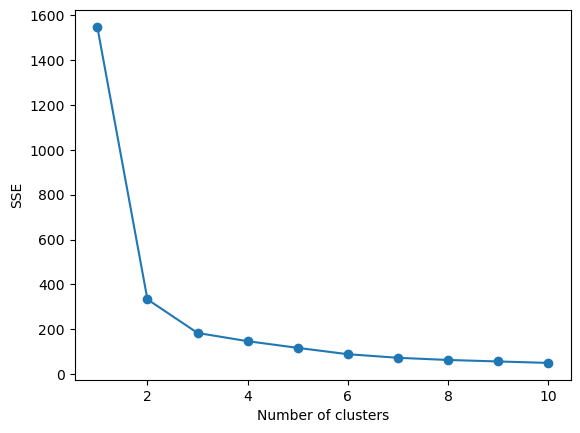

In [7]:
# сделаем кластеризацию самым простым способом -- KMeans
# с помощью elbow method будем выбирать количество кластеров

sse = []

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(scaled_data[['BALANCE', 'PURCHASES_FREQUENCY']])
    sse.append(kmeans.inertia_)

plt.plot(range(1, 11), sse, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('SSE')
plt.show()
# получаем, что оптимальное количество кластеров = 2

In [8]:
labels = KMeans(n_clusters=2).fit_predict(scaled_data[['BALANCE', 'PURCHASES_FREQUENCY']])
scaled_data['clusters'] = labels
scaled_data.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,0.002148,0.818182,0.001945,0.000000,0.00424,0.000000,0.166667,0.000000,0.083333,0.000000,0.00000,0.005587,0.031720,0.003979,0.001826,0.000000,1.0,0
1,0.168169,0.909091,0.000000,0.000000,0.00000,0.136685,0.000000,0.000000,0.000000,0.166667,0.03252,0.000000,0.232053,0.080893,0.014034,0.222222,1.0,0
2,0.131026,1.000000,0.015766,0.018968,0.00000,0.000000,1.000000,1.000000,0.000000,0.000000,0.00000,0.033520,0.248748,0.012264,0.008210,0.000000,1.0,1
3,0.087521,0.636364,0.030567,0.036775,0.00000,0.004366,0.083333,0.083333,0.000000,0.055555,0.00813,0.002793,0.248748,0.000000,NaN,0.000000,1.0,0
4,0.042940,1.000000,0.000326,0.000393,0.00000,0.000000,0.083333,0.083333,0.000000,0.000000,0.00000,0.002793,0.038397,0.013374,0.003204,0.000000,1.0,0


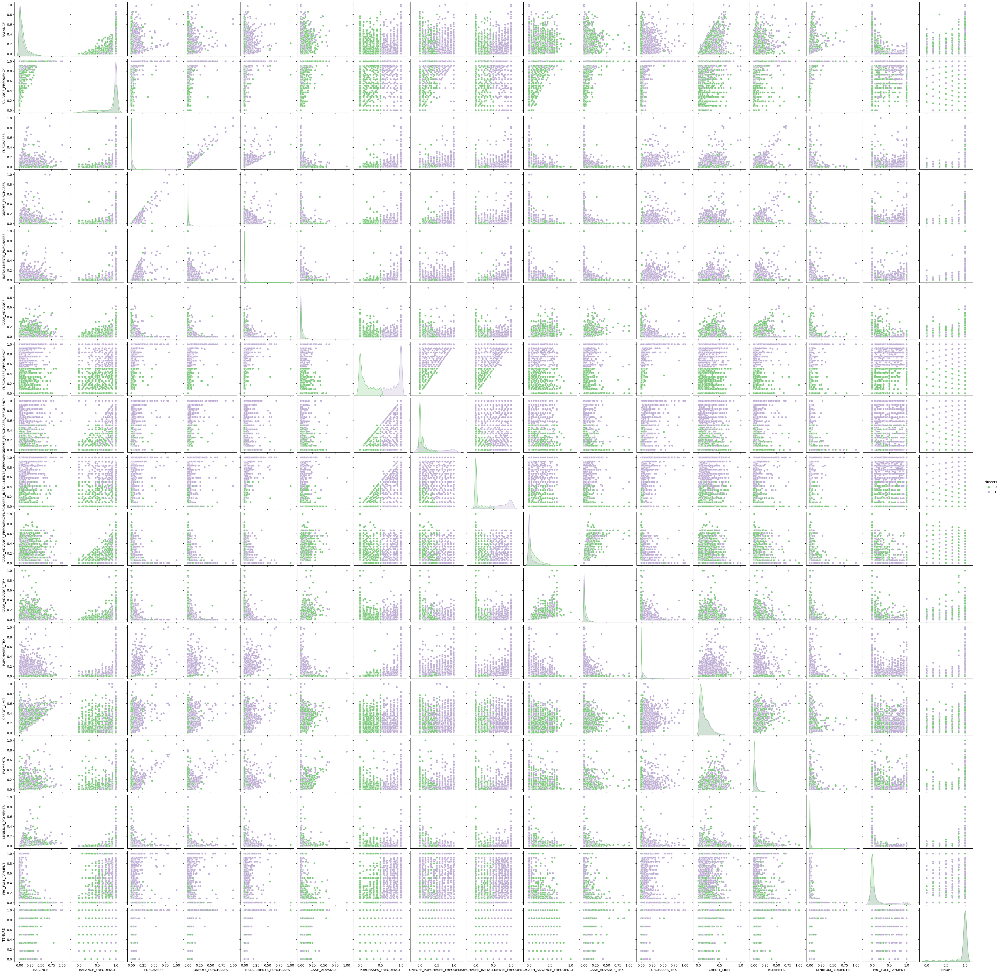

In [9]:
sns.pairplot(scaled_data, hue='clusters', palette='Accent')

Попробуем увеличить количество признаков: возьмем все за исключением тех, которые имеют сильную корреляцию (из ONEOFF_PURCHASES и PURCHASES оставим PURCHASES). Попробуем KMeans на этих признаках

In [10]:
scaled_data.drop('ONEOFF_PURCHASES', axis=1, inplace=True)
# дропнем nanы, их не так много, в целом нестрашно
scaled_data.dropna(inplace=True)

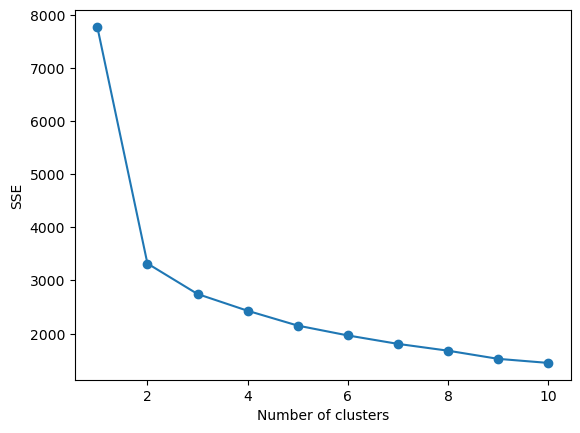

In [11]:
sse = []

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(scaled_data)
    sse.append(kmeans.inertia_)

plt.plot(range(1, 11), sse, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('SSE')
plt.show()
# опять получаем, что оптимальное количество кластеров = 2

In [12]:
labels = KMeans(n_clusters=2).fit_predict(scaled_data)
scaled_data['clusters'] = labels
scaled_data.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,clusters
0,0.002148,0.818182,0.001945,0.004240,0.000000,0.166667,0.000000,0.083333,0.000000,0.00000,0.005587,0.031720,0.003979,0.001826,0.000000,1.0,0
1,0.168169,0.909091,0.000000,0.000000,0.136685,0.000000,0.000000,0.000000,0.166667,0.03252,0.000000,0.232053,0.080893,0.014034,0.222222,1.0,0
2,0.131026,1.000000,0.015766,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.00000,0.033520,0.248748,0.012264,0.008210,0.000000,1.0,1
4,0.042940,1.000000,0.000326,0.000000,0.000000,0.083333,0.083333,0.000000,0.000000,0.00000,0.002793,0.038397,0.013374,0.003204,0.000000,1.0,0
5,0.095038,1.000000,0.027188,0.059257,0.000000,0.666667,0.000000,0.583333,0.000000,0.00000,0.022346,0.058431,0.027603,0.031506,0.000000,1.0,1


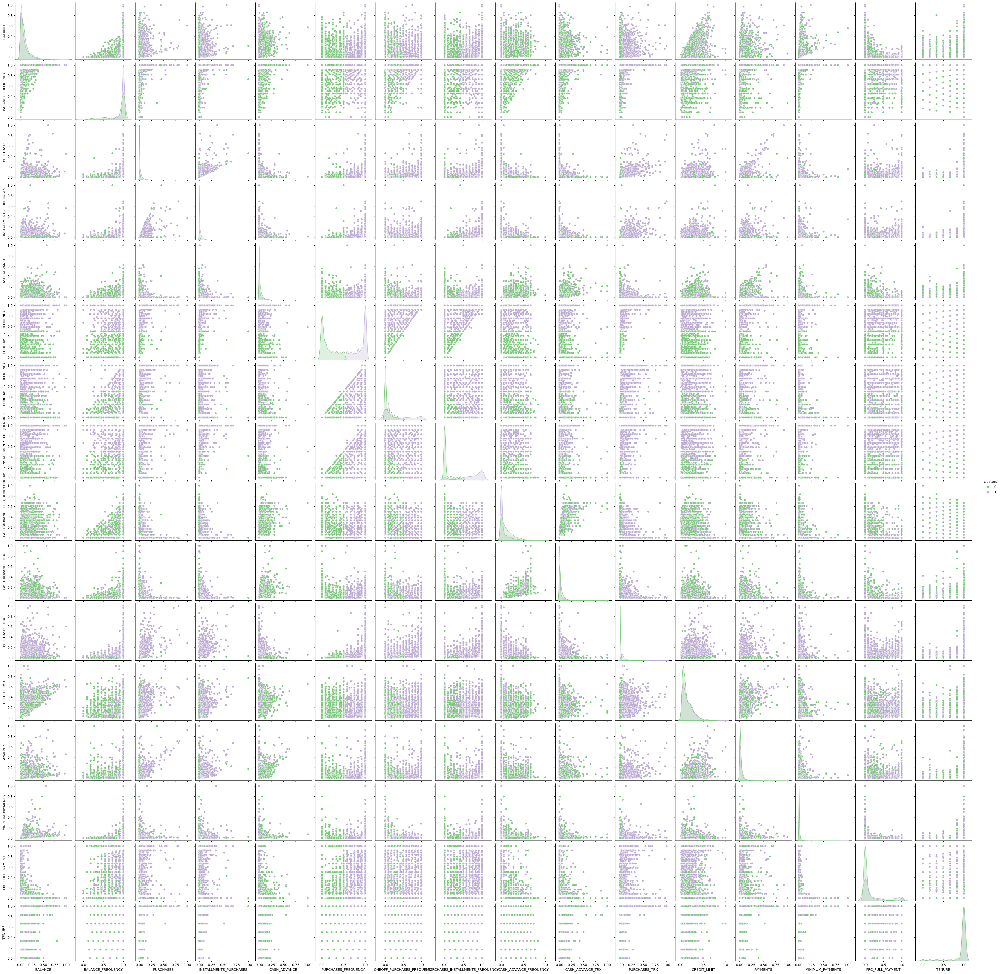

In [13]:
# и еще раз посмотрим
sns.pairplot(scaled_data, hue='clusters', palette='Accent')

Можно заметить, что в обоих случаях получили +- одинаковое качество кластеризации: неплохая кластеризация получается по признаку 'PURCHASES_FREQUENCY' и хоть какая-то неплохая по признакам 'INSTALLMENTS_PURCHASES', 'PURCHASES', 'PURCHASESINSTALLMENTSFREQUENCY', 'PURCHASES_TRX' (качество +- одинаково плохое, но признаки в целом тоже об одном и том же)

Исходная гипотеза в плане желания поделить по уровню состоятельности не подтвердилась, но один из начальных признаков действительно имеет большое значения для кластеризации

Можно ли как-то интерпретировать кластеры: по сути мы получили 2 группы -- те, кто часто делает покупки, и те, кто не очень часто

## Normal

In [14]:
from sklearn.cluster import AgglomerativeClustering, DBSCAN

Будем делать кластеризации на почти всех признаков (кроме того, который выкинули). В качестве методов возьмем KMeans, DBSCAN и иерархическую кластеризацию

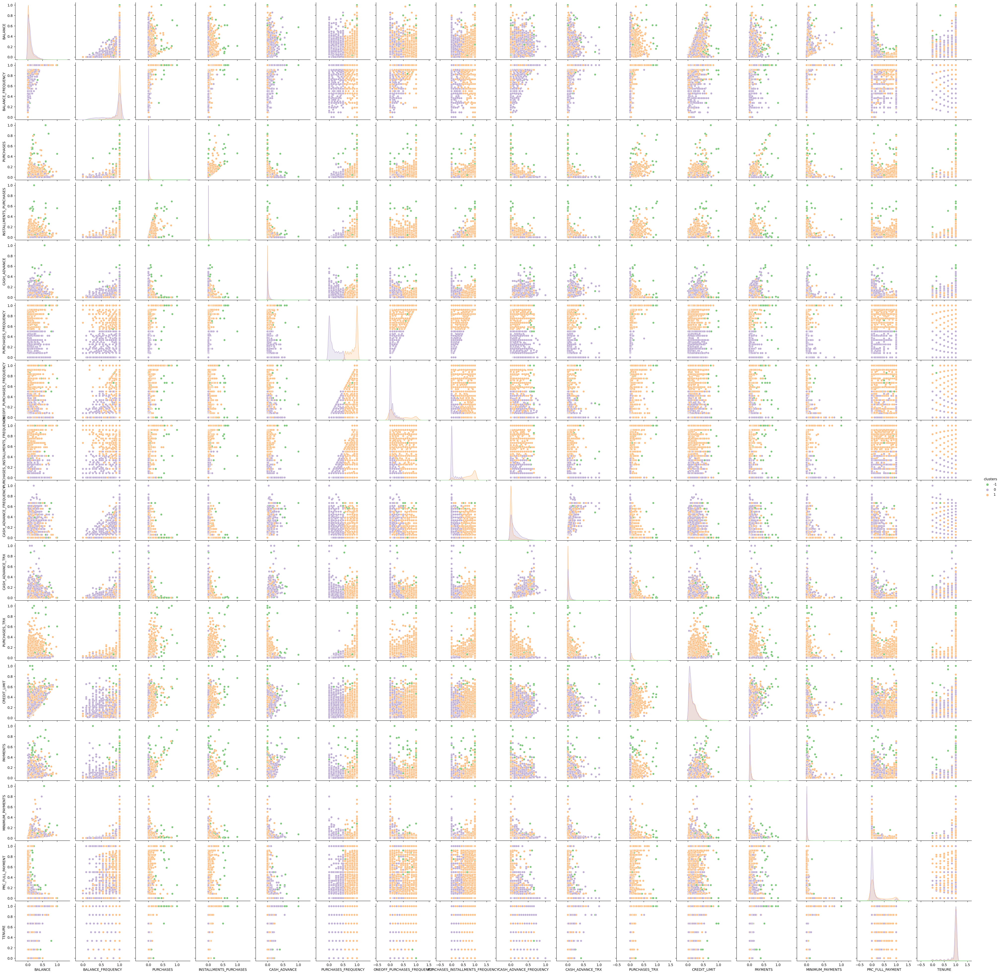

In [15]:
def dbscan_clustering(data):
    dbscan = DBSCAN()
    labels = dbscan.fit_predict(data)
    scaled_data['clusters'] = labels
    sns.pairplot(scaled_data, hue='clusters', palette='Accent')
    plt.show()
    
dbscan_clustering(scaled_data)

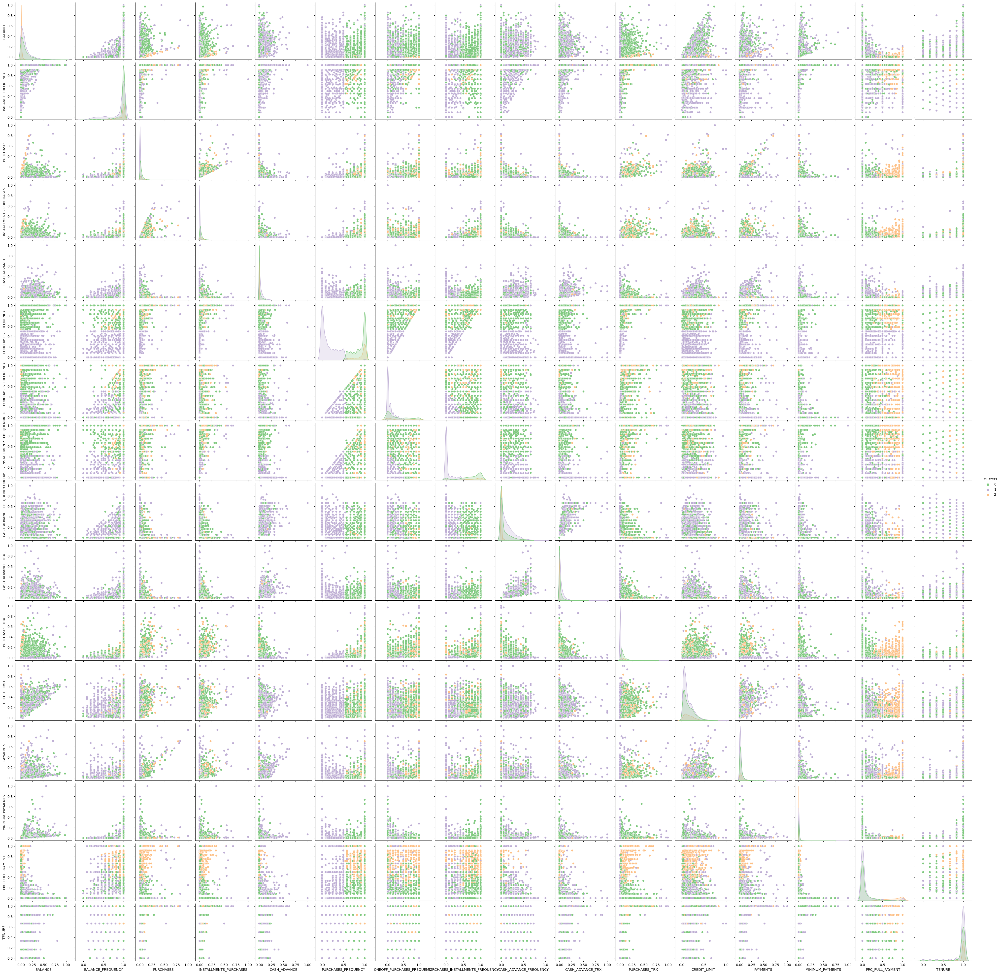

In [16]:
def hierarchical_clustering(data, n_clusters):
    hierarchical = AgglomerativeClustering(n_clusters=n_clusters)
    labels = hierarchical.fit_predict(data)
    scaled_data['clusters'] = labels
    sns.pairplot(scaled_data, hue='clusters', palette='Accent')
    plt.show()
    
hierarchical_clustering(scaled_data, 3)

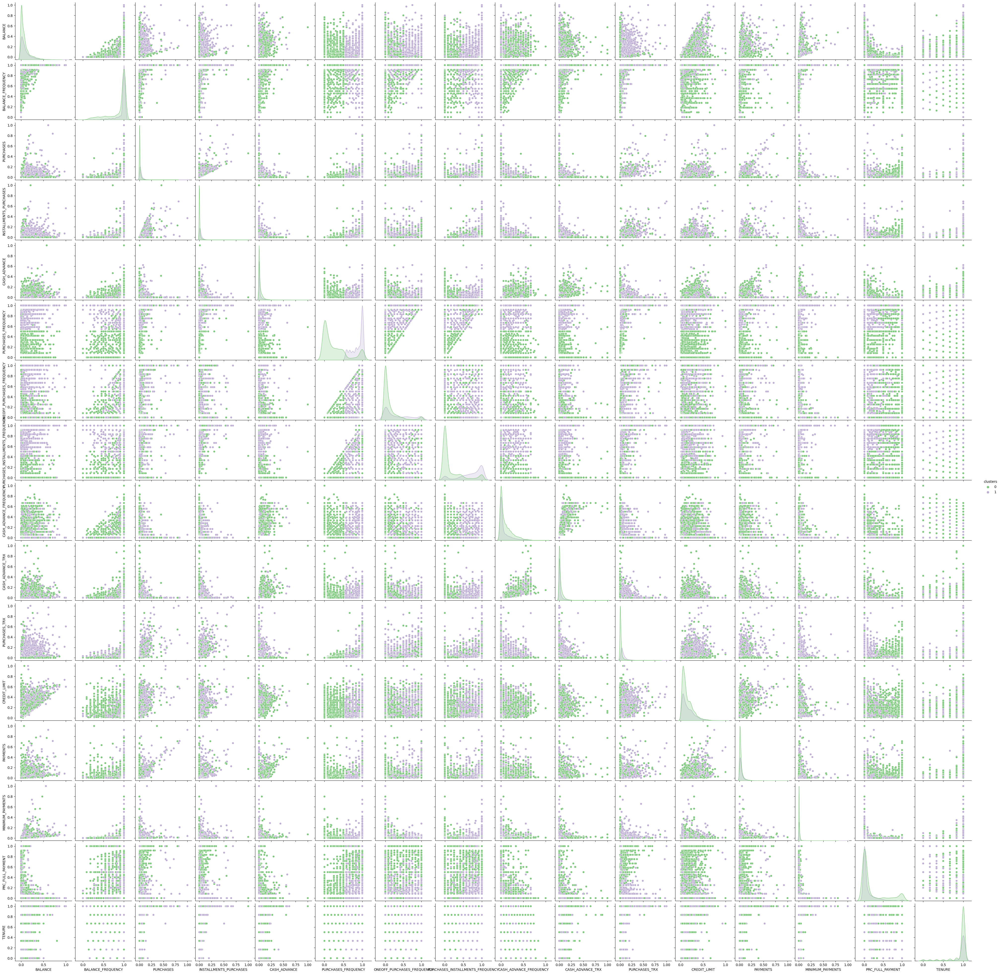

In [17]:
hierarchical_clustering(scaled_data, 2)

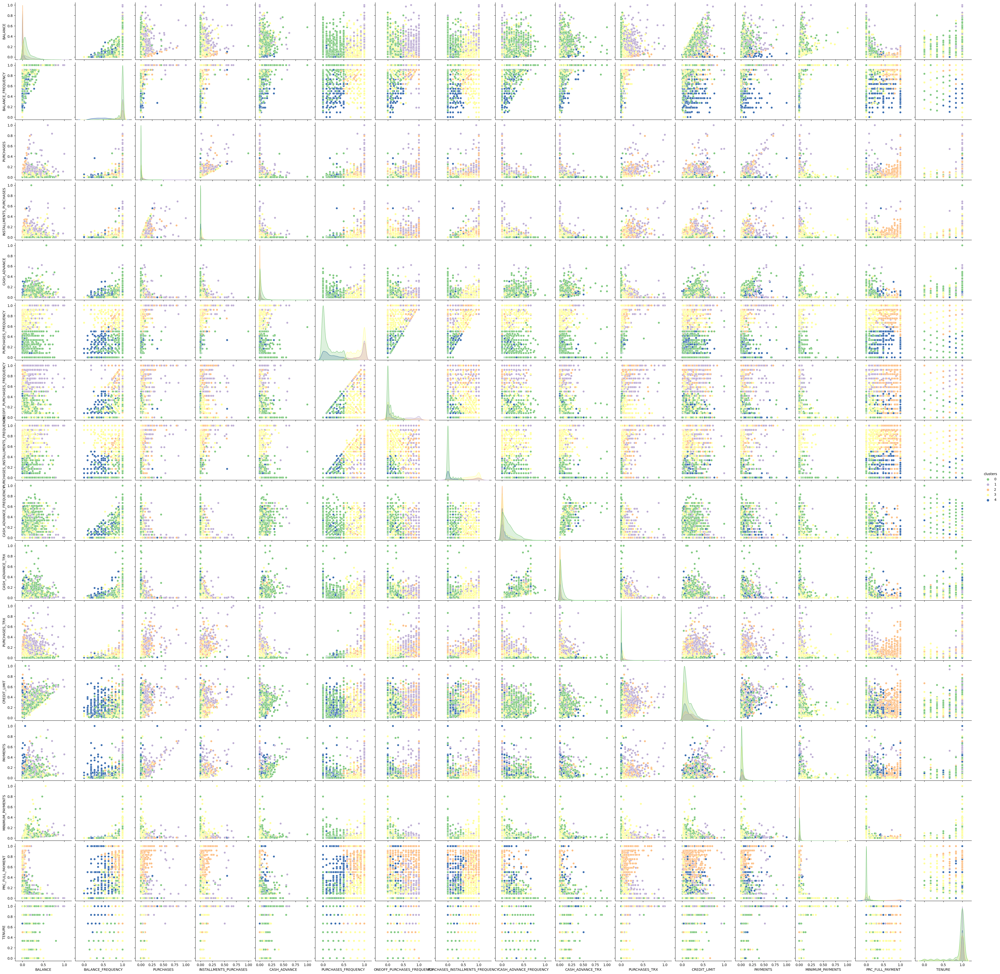

In [18]:
hierarchical_clustering(scaled_data, 5)

Можно заметить, что кластеризация везде +- не очень и больше чем на 2 кластера делить хоть сколько-то разумно не получается. А на 2 кластера всеми методами примерно одинаково делится, так что интерпретация в пункте easy
Еще можно заметить, что DBSCAN поделил на 3 кластера и к 3 кластеру в большинстве отнес точки, которые являются "выбросами" (сильно отличаются от остальных)